# Lab CMBLenses

In [38]:
using Pkg
Pkg.activate(".")
Pkg.instantiate()

  Activating project at `/global/u2/j/jaimerz/PhD/MicroCanonicalHMC.jl/examples`


In [39]:
using Revise, Adapt, CMBLensing, CMBLensingInferenceTestProblem, CUDA,
    JLD2, LaTeXStrings, LinearAlgebra, 
    MCMCChains, MCMCDiagnosticTools, MicroCanonicalHMC, MuseInference, MuseInference, Plots, 
    ProgressMeter, Random, Statistics, Zygote

In [40]:
Plots.default(fmt=:png, dpi=120, size=(500,300), legendfontsize=10)

In [41]:
Nside = 512
T = Float64
masking = true
prob = load_cmb_lensing_problem(;storage=CuArray, T, Nside, masking=masking, global_parameters=false);

In [42]:
function get_mask_distance(prob)
    prob.ds.M isa LazyBinaryOp || error("masking must be enabled")
    mx = diag(prob.ds.M[2])[:Qx] .== 1;
    nearest = getfield.(@eval(CMBLensing,@ondemand(ImageMorphology.feature_transform))(mx), :I)
    Ny, Nx = size(mx)
    return [norm(nearest[i,j] .- [i,j]) for i=1:Ny,j=1:Nx]
end

get_mask_distance (generic function with 1 method)

In [43]:
dist_mat = get_mask_distance(prob);

┌ Warning: Performing scalar indexing on task Task (runnable) @0x00007f8788316720.
│ Invocation of getindex resulted in scalar indexing of a GPU array.
│ This is typically caused by calling an iterating implementation of a method.
│ Such implementations *do not* execute on the GPU, but very slowly on the CPU,
│ and therefore are only permitted from the REPL for prototyping purposes.
│ If you did intend to index this array, annotate the caller with @allowscalar.
└ @ GPUArraysCore ~/.julia/packages/GPUArraysCore/HaQcr/src/GPUArraysCore.jl:106


LoadError: GPU compilation of MethodInstance for (::GPUArrays.var"#broadcast_kernel#28")(::CUDA.CuKernelContext, ::CuDeviceMatrix{Tuple{Int64, Int64}, 1}, ::Base.Broadcast.Broadcasted{CUDA.CuArrayStyle{2}, Tuple{Base.OneTo{Int64}, Base.OneTo{Int64}}, typeof(getfield), Tuple{Base.Broadcast.Extruded{CuDeviceMatrix{CartesianIndex{2}, 1}, Tuple{Bool, Bool}, Tuple{Int64, Int64}}, CUDA.CuRefValue{Symbol}}}, ::Int64) failed
KernelError: passing and using non-bitstype argument

Argument 4 to your kernel function is of type Base.Broadcast.Broadcasted{CUDA.CuArrayStyle{2}, Tuple{Base.OneTo{Int64}, Base.OneTo{Int64}}, typeof(getfield), Tuple{Base.Broadcast.Extruded{CuDeviceMatrix{CartesianIndex{2}, 1}, Tuple{Bool, Bool}, Tuple{Int64, Int64}}, CUDA.CuRefValue{Symbol}}}, which is not isbits:
  .args is of type Tuple{Base.Broadcast.Extruded{CuDeviceMatrix{CartesianIndex{2}, 1}, Tuple{Bool, Bool}, Tuple{Int64, Int64}}, CUDA.CuRefValue{Symbol}} which is not isbits.
    .2 is of type CUDA.CuRefValue{Symbol} which is not isbits.
      .x is of type Symbol which is not isbits.



# MCHMC

In [44]:
target = CMBLensingTarget(prob);

In [45]:
d = length(prob.Ωstart)
to_vec, from_vec = CMBLensingInferenceTestProblem.to_from_vec(prob.Ωstart);

In [46]:
#p_precond = load("../chains/pixel_preconditioners/pp_nside_64", 
#               "dist_mat_precond")
#p_precond = adapt(CuArray, p_precond)
#p_precond = from_vec(p_precond[1:end-2]);

In [47]:
precond = one(simulate(Diagonal(one(LenseBasis(diag(prob.Λmass))))));

## Sample

In [48]:
TEV = 0.0001
spl = MCHMC(500, TEV; adaptive=true, init_eps=30, init_L=500, sigma=precond);

In [49]:
prob.ncalls[] = 0
samples_mchmc = adapt(Array, Sample(spl, target, 10_000, dialog=false, progress=true,
                      thinning=20,
                      file_name=string("/pscratch/sd/j/jaimerz/chains/MCHMC/CMBLensing_masking_", masking, "_no_cosmo_Nnside_", Nside, "_TEV_", TEV)));
ncalls_mchmc = prob.ncalls[]

MCHMC: 100%|████████████████████████████████████████████| Time: 0:10:10
  ϵ:     56.8643071410221
  dE/d:  -3.0140184203257072e-6


21000

In [50]:
esss, _ = MicroCanonicalHMC.Summarize(samples_mchmc)

([443497.7696784796, 443499.73118934775, 443548.6483910862, 443648.65998976893, 443529.23509194196, 443853.1243557336, 444041.87573096395, 444071.19747640315, 444058.8121512973, 444132.3831495065  …  447942.8104783747, 447859.0302011329, 447816.84326533217, 447865.14004639664, 447909.1803387855, 447724.5113587446, 447768.1879588123, 447937.24595415435, 447633.82234447775, 447887.00763655244], [1.1490633285392147, 1.1490631236826563, 1.1490303013710905, 1.1490968763107237, 1.1490942630972516, 1.1492071237162107, 1.149209539617535, 1.1492088848233892, 1.1491827417376115, 1.1491421385047573  …  1.151732491336514, 1.1517890315929238, 1.1517818723501734, 1.1518454121817026, 1.151816470067564, 1.1517774262923988, 1.1516937130526443, 1.1517689082000835, 1.1517840478079076, 1.1517955157211313])

In [51]:
ess_per_call_mchmc = mean(esss[1:end-3]) / 10_000

44.6691757335662

## Plot

In [52]:
std(chain_mchmc[:dE])^2/d

LoadError: UndefVarError: `chain_mchmc` not defined

In [53]:
plot(chain_mchmc[:dE]/d, label=L"\mathrm{Energy}/d", xlabel="step")

LoadError: UndefVarError: `chain_mchmc` not defined

In [54]:
vars = var(samples_mchmc, dims=2)[1:d]
_vars = var(samples_mchmc, dims=2)[d+1:2*d]

786432-element Vector{Float64}:
 1.1108130519370392
 1.5244492014862625
 1.6215043371723876
 0.8517586680348251
 1.7893922270195886
 2.5977883465359737
 1.2314595866861369
 1.5881507104319104
 1.0228526461941823
 1.6148258568452847
 2.539656811469511
 5.5050626044178905
 2.729767719101816
 ⋮
 1.0931695433317452
 0.8189372855817106
 1.2617333268163646
 0.7479645849103689
 1.2195285217697511
 1.3815093595505674
 1.132735890971566
 0.9146540990928224
 1.0937115063721627
 1.7494998934994206
 1.069975008537114
 0.8944355069226431

In [55]:
k = round(maximum(vars)/minimum(vars), digits=2)
_k = round(maximum(_vars)/minimum(_vars), digits=2)

84.49

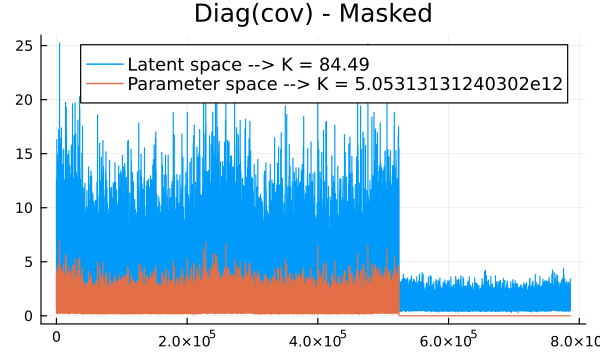

In [56]:
plot(_vars, title="Diag(cov) - Masked", label=string("Latent space --> K = ", _k))
plot!(vars, label=string("Parameter space --> K = ", k))

In [57]:
using CMBLensing: fit, Histogram, Weights
_vars_q = _vars[1:Int(d/3)]
_vars_u = _vars[Int((d)/3)+1:Int(2*(d)/3)];

In [58]:
_edges = range(0,13,length=20)
hist_vars_q = fit(Histogram, vec(dist_mat), Weights(_vars_q), _edges).weights ./ fit(Histogram, vec(dist_mat), Weights(ones(length(_vars_q))), _edges).weights
hist_vars_u = fit(Histogram, vec(dist_mat), Weights(_vars_u), _edges).weights ./ fit(Histogram, vec(dist_mat), Weights(ones(length(_vars_q))), _edges).weights
plot(_edges, hist_vars_q, seriestype=:scatter,
     xlabel="distance to edge",
     ylabel="variance of pixel",
     label="Q-field", alpha=0.7)
plot!(_edges, hist_vars_u, seriestype=:scatter,
     xlabel="distance to edge",
     ylabel="variance of pixel",
     label="U-field", alpha=0.7)

LoadError: UndefVarError: `dist_mat` not defined

### Animation

In [59]:
to_vec, from_vec = CMBLensingInferenceTestProblem.to_from_vec(prob.Ωstart)
last_sample = from_vec(samples_mchmc[end][1:end-2]);

LoadError: MethodError: no method matching getindex(::Float64, ::UnitRange{Int64})

[0mClosest candidates are:
[0m  getindex(::Union{Real, Field, FieldOp}, [91m::typeof(!)[39m, [91m::Any[39m)
[0m[90m   @[39m [36mCMBLensing[39m [90m~/.julia/packages/CMBLensing/nQI1O/src/[39m[90m[4mgeneric.jl:365[24m[39m
[0m  getindex(::Number)
[0m[90m   @[39m [90mBase[39m [90m[4mnumber.jl:95[24m[39m
[0m  getindex(::Union{AbstractChar, Number}, [91m::CartesianIndex{0}[39m)
[0m[90m   @[39m [90mBase[39m [90m[4mmultidimensional.jl:853[24m[39m
[0m  ...


In [60]:
ps = map([(:ϕ°,:I,L"L",L"\phi^\circ"), (:f°,:E,"L\ell",L"E^\circ"), (:f°,:B,L"\ell",L"B^\circ")]) do (k1, k2, xlabel, title)
    plot(get_Cℓ(prob.Ωtrue[k1][k2]); label="true", xlabel, title)
    plot!(get_Cℓ(prob.Ωstart[k1][k2]); label="start", xlabel, title)
    plot!(get_Cℓ(last_sample[k1][k2]); label="last sample", xlabel, title)
end
plot(ps..., layout=(1,3), xscale=:log10, yscale=:log10, size=(1000,300), legend=:bottomleft)

LoadError: UndefVarError: `last_sample` not defined

In [61]:
ϕs = [∇²*from_vec(sample[1:end-2]).ϕ°/2 for sample in samples_mchmc[end-500:end]]
anim = @animate for i in 1:length(ϕs)
    motionblur = [0.5, 1, 0.5]
    frame = sum(circshift(ϕs, i)[1:length(motionblur)] .* motionblur) / sum(motionblur)
    plot(1 * frame, clims=(-0.5, 0.5), c=:thermal, title="κ samples")
end;

LoadError: MethodError: no method matching getindex(::Float64, ::UnitRange{Int64})

[0mClosest candidates are:
[0m  getindex(::Union{Real, Field, FieldOp}, [91m::typeof(!)[39m, [91m::Any[39m)
[0m[90m   @[39m [36mCMBLensing[39m [90m~/.julia/packages/CMBLensing/nQI1O/src/[39m[90m[4mgeneric.jl:365[24m[39m
[0m  getindex(::Number)
[0m[90m   @[39m [90mBase[39m [90m[4mnumber.jl:95[24m[39m
[0m  getindex(::Union{AbstractChar, Number}, [91m::CartesianIndex{0}[39m)
[0m[90m   @[39m [90mBase[39m [90m[4mmultidimensional.jl:853[24m[39m
[0m  ...


In [62]:
mp4(anim, "kappa_samples.mp4", fps = 25)

LoadError: UndefVarError: `anim` not defined

# HMC

In [63]:
Ω = prob.Ωstart
samples_hmc = []
rng = Xoshiro(1)
prob.ncalls[] = 0
ϵ=0.05
iterations = 1_000
@showprogress for i=1:iterations
    Ω, = state = hmc_step(rng, prob, Ω, prob.Λmass; symp_kwargs=[(N=25, ϵ=ϵ)], progress=false, always_accept=(i<10))
    push!(samples_hmc, adapt(Array, state))
end
ncalls_hmc = prob.ncalls[]

Progress: 100%|█████████████████████████████████████████| Time: 0:19:20


28000

In [64]:
_samples_hmc = []
@showprogress for i in 1:iterations
   push!(_samples_hmc, samples_hmc[i][1][:])
end

Progress: 100%|█████████████████████████████████████████| Time: 0:00:01


In [65]:
@save string("/pscratch/sd/j/jaimerz/chains/HMC/CMBLensing_masking_", masking, "_no_cosmo_Nnside_", Nside, "_ϵ_", ϵ) _samples_hmc

In [ ]:
esss, _ = MicroCanonicalHMC.Summarize(_samples_hmc)

In [ ]:
ess_per_call_hmc = mean(esss) ./ ncalls_hmc

## Plot

In [ ]:
plot(
    map(result.history[1:1:end]) do h
        p = plot()
        for x in h.ẑ_history_sims
            plot!(first.(x), yscale=:log10)
        end
        plot!(first.(h.ẑ_history_dat), yscale=:log10, c=:black)
        p
    end...,
    size = (1000,500),
    xticks = 0:2:15,
    # ylim = (1e-7, 1e-3)
)

In [ ]:
plot(
    map(result.history[1:1:end]) do h
        p = plot()
        for x in h.ẑ_history_sims
            plot!(last.(x), yscale=:log10)
        end
        plot!(last.(h.ẑ_history_dat), yscale=:log10, c=:black)
        p
    end...,
    size = (1000,500),
    xticks = 0:2:15,
    ylim = (1e-7, 1e-3)
)

In [ ]:
plot(
    plot(getindex.([getindex.(result.history, :θ); [result.θ]], :r), m="."),
    plot(getindex.([getindex.(result.history, :θ); [result.θ]], :Aϕ), m=".")
)

# Compare

In [ ]:
ess_per_call_mchmc

In [ ]:
ess_per_call_hmc

In [ ]:
ess_per_call_muse

In [ ]:
which_ess = minimum # can be: first (r), last (Aphi), or minimum
bar(
    ["HMC" "MCHMC"],
    which_ess.([[ess_per_call_hmc] [ess_per_call_mchmc]]),
    ylabel = "eff. samples / ∇logP eval", legend=false,
    title=string("Masked - Nside=", Nside))